In [1]:
ROOT_DIR = "/home/user/Documents/projects/Metaworld"

import sys
sys.path.append(ROOT_DIR)

%matplotlib widget  
import argparse
import gc
import os
import json
import random
from PIL import Image
from typing import Dict, List, Union

import cv2
import numpy as np

import gc
import matplotlib.pyplot as plt
import torch
from torchvision.transforms import PILToTensor
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from scipy.spatial.transform import Rotation as R
import importlib
from typing import List
from easydict import EasyDict as edict
from tqdm import tqdm

# visualization
import plotly.express as px
import plotly.graph_objects as go
from lightglue import viz2d
from einops import rearrange

In [2]:
from keyframes.align_ft_spair import dataset
from keyframes.align_ft_spair.utils import geo_utils, spair_utils, ft_align_utils, depth_match_utils, geom_utils, img_utils
from keyframes.align_ft_spair import pl_modules
from keyframes.align_ft_spair.ext import projection_network, utils_correspondence, utils_dataset
from utils import torch_utils

In [3]:
# params
spair_data_folder="/media/user/ssd2t/datasets2/SPair-71k"
embds_folder_geo="/media/user/EXTREMESSD/datasets/SPair-71k/geo"
embds_folder_sd="/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures60x60"
img_files_np_path_train="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_train_files_unique.npy"
img_files_np_path_eval="/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_eval_files_unique.npy"
depth_folder = "/media/user/EXTREMESSD/datasets/SPair-71k/miragold"
kpt_indices=[3, 4, 5]
category="aeroplane"
img_size=960
embd_size=60
pad=True

img_files_train = np.load(img_files_np_path_train).tolist()
img_files_eval = np.load(img_files_np_path_eval).tolist()

flips_train = [False]
flips_eval = [False]

In [38]:
importlib.reload(spair_utils)

<module 'keyframes.align_ft_spair.utils.spair_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/spair_utils.py'>

In [39]:
# load embeddings
img_embds_train, img_embds_hat_train = geo_utils.load_geo_embds(
    img_files_train,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_train,
)
img_embds_train = img_embds_train.detach().cpu()
img_embds_hat_train = img_embds_hat_train.detach().cpu()

# load embeddings
img_embds_eval, img_embds_hat_eval = geo_utils.load_geo_embds(
    img_files_eval,
    embds_folder_dino=embds_folder_geo,
    embds_folder_sd=embds_folder_sd,
    flips=flips_eval,
)
img_embds_eval = img_embds_eval.detach().cpu()
img_embds_hat_eval = img_embds_hat_eval.detach().cpu()

# build kpt_idx_to_kpt_embds
kpt_idx_to_kpt_embds_train, kpt_embd_coords_train, kpt_img_coords_train = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_train,
    img_embds_hat=img_embds_hat_train,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_train
)
kpt_idx_to_kpt_embds_eval, kpt_embd_coords_eval, kpt_img_coords_eval = spair_utils.build_kpt_idx_to_kpt_embds(
    img_files=img_files_eval,
    img_embds_hat=img_embds_hat_eval,
    spair_data_folder=spair_data_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=pad,
    flips=flips_eval
)

# average keypoint embeddings
kpt_features_avg_train = []
for kpt_index in range(30):
    kpt_features = kpt_idx_to_kpt_embds_train[kpt_index]
    if kpt_features is not None:
        kpt_features_avg_train.append(torch.mean(kpt_features, dim=0, keepdim=True))
kpt_features_avg_train = torch.cat(kpt_features_avg_train, dim=0)
# print(kpt_features_avg_train.shape)

# 1.1) load depth
depths_train = []
for img_file in img_files_train:
    fn = os.path.basename(img_file).split(".")[0]
    depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
    depth = np.load(depth_file)
    # NOTE instead of resizing depth we will resize and upscale attentions
    depths_train.append(depth)

depths_eval = []
for img_file in img_files_eval:
    fn = os.path.basename(img_file).split(".")[0]
    depth_file = f"{depth_folder}/{category}/depth_npy/{fn}_pred.npy"
    depth = np.load(depth_file)
    depths_eval.append(depth)

# 1.3) reproject to point clouds
xyz_train = []
for depth in depths_train:
    v0 = geom_utils.reproject_depth(depth)
    xyz_train.append(v0)

xyz_eval = []
for depth in depths_eval:
    v0 = geom_utils.reproject_depth(depth)
    xyz_eval.append(v0)

# px.imshow(depths_padded_resized_train[20])

# New Match Pipeline V3

In [5]:
# 1) extract stable points that are both present in src and tgt image
#   => only stable points can be used as support vectors => we need at least two stable points
# [ 2) extract unstable points that are both present in src and tgt image
# [    => check if point has multiple matches
#   => first we can try with stable points only
# 3) implement function that takes in query location and points extracted above and outputs correct match

In [45]:
kpt_index = 4
q_embd = kpt_features_avg_train[kpt_index]
all_stable_indices = [0,1,2,3,22,23,24]

img_index_src = 2
img_index_tgt = 3

img_embd_src = img_embds_train[img_index_src]
img_embd_tgt = img_embds_train[img_index_tgt]

xyz_src = xyz_train[img_index_src]
xyz_tgt = xyz_train[img_index_tgt]

kpt_attn_src, kpt_attn_max_src = ft_align_utils.compute_kpt_attn(
    img_embd_src,
    kpt_features_avg_train=kpt_features_avg_train
)
kpt_attn_tgt, kpt_attn_max_tgt = ft_align_utils.compute_kpt_attn(
    img_embd_tgt,
    kpt_features_avg_train=kpt_features_avg_train
)

In [7]:
importlib.reload(ft_align_utils)

<module 'keyframes.align_ft_spair.utils.ft_align_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/ft_align_utils.py'>

In [8]:
img_embd_src.shape

torch.Size([2048, 60, 60])

In [9]:
xyz_src.shape

(333, 500, 3)

In [10]:
# upscale attention to original resolution
local_maxima_src, attn_src = ft_align_utils.extract_local_maxima_from_query(img_embd_src, q_embd, xyz_src.shape[0], xyz_src.shape[1])
local_maxima_tgt, attn_tgt = ft_align_utils.extract_local_maxima_from_query(img_embd_tgt, q_embd, xyz_tgt.shape[0], xyz_tgt.shape[1])
print(attn_src[local_maxima_src[:,1], local_maxima_src[:,0]])
print(attn_tgt[local_maxima_tgt[:,1], local_maxima_tgt[:,0]])

tensor([0.0005, 0.0005])
tensor([0.0005, 0.0005])


In [11]:
# 1) extract stable points that are both present in src and tgt image
stable_indices_src, stable_index_to_xyz_src = ft_align_utils.extract_stable_keypoints(
    kpt_attn=kpt_attn_src,
    kpt_attn_max=kpt_attn_max_src,
    img_xyz=xyz_src,
    stable_keypoint_indices=all_stable_indices,
    thresh_rate=0.8,
    input_img_is_padded=True
)
stable_indices_tgt, stable_index_to_xyz_tgt = ft_align_utils.extract_stable_keypoints(
    kpt_attn=kpt_attn_tgt,
    kpt_attn_max=kpt_attn_max_tgt,
    img_xyz=xyz_tgt,
    stable_keypoint_indices=all_stable_indices,
    thresh_rate=0.8,
    input_img_is_padded=True
)

stable_indices_set_src = set(stable_indices_src)
stable_indices_set_tgt = set(stable_indices_tgt)
stable_indices_union = list(stable_indices_set_src.intersection(stable_indices_set_tgt))
stable_xyz_src, stable_xyz_tgt = [], []
for idx in stable_indices_union:
    stable_xyz_src.append(torch_utils.to_torch(stable_index_to_xyz_src[idx], device="cpu"))
    stable_xyz_tgt.append(torch_utils.to_torch(stable_index_to_xyz_tgt[idx], device="cpu"))
stable_xyz_src = torch.stack(stable_xyz_src, dim=0)
stable_xyz_tgt = torch.stack(stable_xyz_tgt, dim=0)

In [86]:
def compute_orientation(q_xyz, stable_points_xyz):
    n = stable_points_xyz.shape[0]
    edges = []
    triangle_normals = []
    # TODO this is inefficient => better compute mask first for points that are valid
    for i in range(n):
        for j in range(i+1, n):
            q_v1 = stable_points_xyz[i] - q_xyz
            q_v2 = stable_points_xyz[j] - q_xyz
            cross_product = torch.zeros(3)
            edge = torch.zeros(3)
            # only compute cross product and edge if both points are valid
            if torch.norm(stable_points_xyz[i]) > 1e-9 and torch.norm(stable_points_xyz[j]) > 1e-9:
                cross_product = torch.cross(q_v1, q_v2)
                edge = stable_points_xyz[j] - stable_points_xyz[i]
            triangle_normals.append(cross_product)
            edges.append(edge)
    
    triangle_normals = torch.stack(triangle_normals, dim=0)
    triangle_normals = triangle_normals / (torch.norm(triangle_normals, dim=1, keepdim=True) + 1e-6)
    edges = torch.stack(edges, dim=0)
    edges = edges / (torch.norm(edges, dim=1, keepdim=True) + 1e-6)

    # project edges on triangle normals
    projections = triangle_normals @ edges.T
    projections[:, torch.norm(edges, dim=1, keepdim=False) < 1e-6] = 0
    projections[torch.norm(triangle_normals, dim=1, keepdim=False) < 1e-6, :] = 0

    return projections

def compute_orientation_v2(v1_xyz, v2_xyz, stable_points_xyz):
    n = stable_points_xyz.shape[0]
    edges = []
    triangle_normals = []
    # TODO this is inefficient => better compute mask first for points that are valid
    v1v2 = v2_xyz - v1_xyz
    for i in range(n):
        vi = stable_points_xyz[i]
        triangle_normal = torch.zeros(3)
        if torch.norm(vi) > 1e-9:
            v1vi = vi - v1_xyz
            triangle_normal = torch.cross(v1v2, v1vi)
        triangle_normals.append(triangle_normal)
        for j in range(i+1, n):
            vj = stable_points_xyz[j]
            edge = torch.zeros(3)
            # only compute cross product and edge if both points are valid
            if torch.norm(vj) > 1e-9:
                edge = vj - vi
            edges.append(edge)
    
    triangle_normals = torch.stack(triangle_normals, dim=0)
    triangle_normals = triangle_normals / (torch.norm(triangle_normals, dim=1, keepdim=True) + 1e-6)
    edges = torch.stack(edges, dim=0)
    edges = edges / (torch.norm(edges, dim=1, keepdim=True) + 1e-6)

    # project edges on triangle normals
    projections = triangle_normals @ edges.T
    projections[:, torch.norm(edges, dim=1, keepdim=False) < 1e-6] = 0
    projections[torch.norm(triangle_normals, dim=1, keepdim=False) < 1e-6, :] = 0

    return projections

In [35]:
# # TODO we should use ground truth data
# def compute_projections(
#     q_embd,
#     img_embd, 
#     img_xyz,
#     kpt_features_avg_train,
#     stable_indices: List[int],
#     thresh_rate=0.8,
#     input_img_is_padded=True
# ):
#     kpt_attn, kpt_attn_max = ft_align_utils.compute_kpt_attn(
#         img_embd,
#         kpt_features_avg_train=kpt_features_avg_train
#     )
#     thresh = thresh_rate * torch.max(kpt_attn_max)
#     local_maxima, attn = ft_align_utils.extract_local_maxima_from_query(img_embd_src, q_embd, xyz_src.shape[0], xyz_src.shape[1])
#     local_maxima_attn = attn[local_maxima[:,1], local_maxima[:,0]]
#     if local_maxima_attn[0] < thresh or local_maxima_attn[1] < 0.9 * local_maxima_attn[0]:
#         print("warning: no two local maxima found")
#         return None
    
#     stable_indices_in_img, stable_index_to_xyz = ft_align_utils.extract_stable_keypoints(
#         kpt_attn=kpt_attn,
#         kpt_attn_max=kpt_attn_max,
#         img_xyz=img_xyz,
#         stable_keypoint_indices=stable_indices,
#         thresh_rate=thresh_rate,
#         input_img_is_padded=input_img_is_padded
#     )
#     stable_xyz = torch.zeros((len(stable_indices), 3), dtype=torch.float32)
#     stable_xyz[list(stable_index_to_xyz.keys())] = list(stable_index_to_xyz.values())

#     v0, v1 = img_xyz[local_maxima_src[:,1], local_maxima_src[:,0]]
#     # TODO how to deal with images with different set of stable indices?
#     projections_v0 = compute_orientation(v0, stable_xyz)
#     projections_v1 = compute_orientation(v1, stable_xyz)
#     return projections_v0, projections_v1

In [87]:
def compute_projection_for_img(
    kpt_index_1,
    kpt_index_2,
    img_embd,
    img_xyz,
    kpt_img_coords_gt: torch.Tensor,
    kpt_features_avg_train: torch.Tensor,
    stable_indices: List[int],
    thresh_rate=0.8,
    input_img_is_padded=True,
):
    img_kpt_indices = kpt_img_coords_gt[:,2]
    kpt_index_1_mask = img_kpt_indices == kpt_index_1
    kpt_index_2_mask = img_kpt_indices == kpt_index_2
    if torch.sum(kpt_index_1_mask) == 0 or torch.sum(kpt_index_2_mask) == 0:
        return None, None
    
    v1_img_coords = kpt_img_coords_gt[kpt_index_1_mask][0,:2]
    v2_img_coords = kpt_img_coords_gt[kpt_index_2_mask][0,:2]
    v1_xyz = img_xyz[v1_img_coords[1], v1_img_coords[0]]
    v2_xyz = img_xyz[v2_img_coords[1], v2_img_coords[0]]
    
    # TODO should we gt data?
    kpt_attn, kpt_attn_max = ft_align_utils.compute_kpt_attn(
        img_embd,
        kpt_features_avg_train=kpt_features_avg_train
    )
    _, stable_index_to_xyz = ft_align_utils.extract_stable_keypoints(
        kpt_attn=kpt_attn,
        kpt_attn_max=kpt_attn_max,
        img_xyz=img_xyz,
        stable_keypoint_indices=stable_indices,
        thresh_rate=thresh_rate,
        input_img_is_padded=input_img_is_padded
    )
    stable_xyz = torch.zeros((len(stable_indices), 3), dtype=torch.double)
    kpt_index_to_stable_index = torch.zeros(30, dtype=torch.int64)
    kpt_index_to_stable_index[stable_indices] = torch.arange(len(stable_indices))
    stable_xyz[kpt_index_to_stable_index[list(stable_index_to_xyz.keys())]] = torch.stack(list(stable_index_to_xyz.values()))

    
    projections_1 = compute_orientation_v2(v1_xyz, v2_xyz, stable_xyz)
    projections_2 = compute_orientation_v2(v2_xyz, v1_xyz, stable_xyz)
    return projections_1, projections_2

In [46]:
all_stable_indices

[0, 1, 2, 3, 22, 23, 24]

In [43]:
img_embds_hat_train.shape[0]

55

In [116]:
# TODO also conduct experiment where only one of the keypoints is available
# TODO treat cases different when there are two keypoints available vs when there is only one available
all_projections_indices, all_projections_1, all_projections_2 = [], [], []
for i in tqdm(range(img_embds_hat_train.shape[0])):
    projections_1, projections_2 = compute_projection_for_img(
        12,
        13,
        img_embds_hat_train[i],
        torch_utils.to_torch(xyz_train[i], device="cpu"),
        kpt_img_coords_train[i],
        kpt_features_avg_train,
        all_stable_indices,
        thresh_rate=0.8,
        input_img_is_padded=True
    )
    if projections_1 is not None and projections_2 is not None:
        all_projections_indices.append(i)
        all_projections_1.append(projections_1)
        all_projections_2.append(projections_2)
    else:
        print(i, "img that does not contain kpt_index_1 and kpt_index_2")

 16%|█▋        | 9/55 [00:00<00:00, 48.59it/s]

0 img that does not contain kpt_index_1 and kpt_index_2
1 img that does not contain kpt_index_1 and kpt_index_2
2 img that does not contain kpt_index_1 and kpt_index_2
3 img that does not contain kpt_index_1 and kpt_index_2
4 img that does not contain kpt_index_1 and kpt_index_2
5 img that does not contain kpt_index_1 and kpt_index_2
6 img that does not contain kpt_index_1 and kpt_index_2
7 img that does not contain kpt_index_1 and kpt_index_2


 35%|███▍      | 19/55 [00:00<00:01, 32.43it/s]

10 img that does not contain kpt_index_1 and kpt_index_2
11 img that does not contain kpt_index_1 and kpt_index_2
12 img that does not contain kpt_index_1 and kpt_index_2
13 img that does not contain kpt_index_1 and kpt_index_2
14 img that does not contain kpt_index_1 and kpt_index_2
15 img that does not contain kpt_index_1 and kpt_index_2
16 img that does not contain kpt_index_1 and kpt_index_2
17 img that does not contain kpt_index_1 and kpt_index_2
19 img that does not contain kpt_index_1 and kpt_index_2
20 img that does not contain kpt_index_1 and kpt_index_2
21 img that does not contain kpt_index_1 and kpt_index_2
22 img that does not contain kpt_index_1 and kpt_index_2
23 img that does not contain kpt_index_1 and kpt_index_2
24 img that does not contain kpt_index_1 and kpt_index_2
25 img that does not contain kpt_index_1 and kpt_index_2
26 img that does not contain kpt_index_1 and kpt_index_2
27 img that does not contain kpt_index_1 and kpt_index_2
28 img that does not contain kp

 55%|█████▍    | 30/55 [00:00<00:00, 43.86it/s]

30 img that does not contain kpt_index_1 and kpt_index_2
32 img that does not contain kpt_index_1 and kpt_index_2


 71%|███████   | 39/55 [00:01<00:00, 26.52it/s]

34 img that does not contain kpt_index_1 and kpt_index_2
36 img that does not contain kpt_index_1 and kpt_index_2
37 img that does not contain kpt_index_1 and kpt_index_2
38 img that does not contain kpt_index_1 and kpt_index_2
39 img that does not contain kpt_index_1 and kpt_index_2
40 img that does not contain kpt_index_1 and kpt_index_2
41 img that does not contain kpt_index_1 and kpt_index_2
42 img that does not contain kpt_index_1 and kpt_index_2
43 img that does not contain kpt_index_1 and kpt_index_2
44 img that does not contain kpt_index_1 and kpt_index_2


 84%|████████▎ | 46/55 [00:01<00:00, 29.28it/s]

47 img that does not contain kpt_index_1 and kpt_index_2


100%|██████████| 55/55 [00:01<00:00, 28.02it/s]

50 img that does not contain kpt_index_1 and kpt_index_2
51 img that does not contain kpt_index_1 and kpt_index_2
52 img that does not contain kpt_index_1 and kpt_index_2
53 img that does not contain kpt_index_1 and kpt_index_2
54 img that does not contain kpt_index_1 and kpt_index_2


In [117]:
all_projections_1 = torch.stack(all_projections_1)
all_projections_1 = all_projections_1.reshape((all_projections_1.shape[0], -1))
all_projections_2 = torch.stack(all_projections_2)
all_projections_2 = all_projections_2.reshape((all_projections_2.shape[0], -1))

In [118]:
mask = (all_projections_1 < all_projections_2).float()
mask[all_projections_1 == 0] = -1
px.imshow(mask)

In [121]:
kpt_attn, kpt_attn_max = ft_align_utils.compute_kpt_attn(
    img_embds_hat_train[all_projections_indices[1]],
    kpt_features_avg_train=kpt_features_avg_train
)
px.imshow(kpt_attn[22])

In [122]:
torch.max(kpt_attn_max)

tensor(0.0005)

In [129]:
0.85 * torch.max(kpt_attn_max)

tensor(0.0004)

In [126]:
# TODO we need a better way to determine whether there is a good match in the image => detect number of images "noisyness"
# => measure number of pixels where gradient is zero in one direction and high in the other direction
kpt_attn_max[22] < 0.85 * torch.max(kpt_attn_max)

tensor(True)

In [101]:
len(all_stable_indices)

7

In [104]:
7+5+4+3+2+1

22

In [114]:
111%21

6

In [109]:
n = len(all_stable_indices)
index_pairs = []
for i in range(n): 
    for j in range(i+1, n):
        p = [all_stable_indices[i], all_stable_indices[j]]
        index_pairs.append(p)
index_pairs

[[0, 1],
 [0, 2],
 [0, 3],
 [0, 22],
 [0, 23],
 [0, 24],
 [1, 2],
 [1, 3],
 [1, 22],
 [1, 23],
 [1, 24],
 [2, 3],
 [2, 22],
 [2, 23],
 [2, 24],
 [3, 22],
 [3, 23],
 [3, 24],
 [22, 23],
 [22, 24],
 [23, 24]]

In [111]:
len(index_pairs)

21

In [120]:
index_pairs[4]

[0, 23]

In [106]:
7*3.5

24.5

In [ ]:
# TODO how can we estimate plane up vector

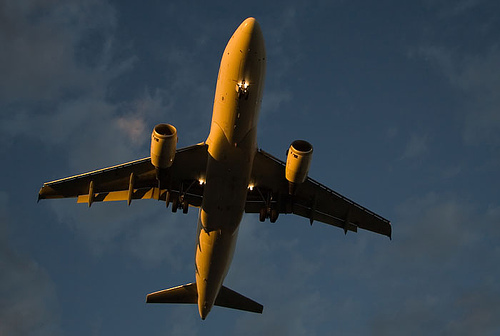

In [99]:
Image.open(img_files_train[all_projections_indices[1]])

In [113]:
px.imshow(xyz_train[all_projections_indices[1]][:,:,2])

In [85]:
mask = (all_projections_1 < all_projections_2).float()
mask[all_projections_1 == 0] = -1
px.imshow(mask)

In [79]:
mask = (all_projections_1 < all_projections_2).float()
mask[all_projections_1 == 0] = -1
px.imshow(mask)

In [81]:
all_projections_indices[2]

9

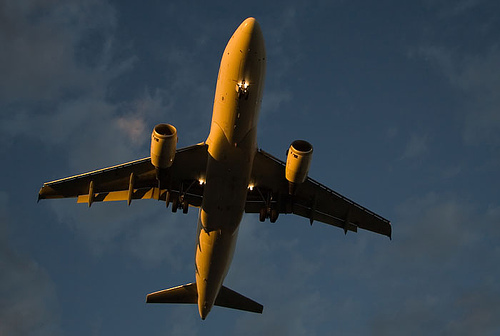

In [82]:
Image.open(img_files_train[9])

In [71]:
mask = (all_projections_1 < all_projections_2).float()
mask[all_projections_1 == 0] = -1
px.imshow(mask)

In [69]:
px.imshow(all_projections_2)

In [36]:
kpt_embd_coords_train[img_index_src]

tensor([[58, 29,  0],
        [55, 26,  1],
        [52, 25,  2],
        [52, 34,  3],
        [30, 36,  4],
        [32, 34,  5],
        [42, 31,  6],
        [38, 33,  7],
        [29, 26,  8],
        [36, 32, 10],
        [34, 34, 11],
        [29, 32, 14],
        [ 4, 29, 16],
        [10, 31, 18],
        [ 4, 31, 20],
        [14, 28, 22],
        [ 2, 20, 23],
        [ 1, 31, 24]])

In [34]:
a = {
    1: 2,
    3: 4
}
print(list(a.keys()), list(a.values()))

[1, 3] [2, 4]


In [13]:
print(attn_src[local_maxima_src[:,1], local_maxima_src[:,0]])
print(attn_tgt[local_maxima_tgt[:,1], local_maxima_tgt[:,0]])

tensor([0.0005, 0.0005])
tensor([0.0005, 0.0005])


In [14]:
px.imshow(attn_src)

In [15]:
px.imshow(xyz_src[:,:,2])

In [16]:
px.imshow(xyz_tgt[:,:,2])

In [17]:
local_maxima_src

array([[254, 220],
       [270, 204]])

In [18]:
local_maxima_tgt

array([[454, 279],
       [371, 246]])

In [19]:
projections_0_src = compute_orientation(xyz_src[local_maxima_src[0,1], local_maxima_src[0,0]], stable_xyz_src)
projections_1_src = compute_orientation(xyz_src[local_maxima_src[1,1], local_maxima_src[1,0]], stable_xyz_src)

projections_0_tgt = compute_orientation(xyz_tgt[local_maxima_tgt[0,1], local_maxima_tgt[0,0]], stable_xyz_tgt)
projections_1_tgt = compute_orientation(xyz_tgt[local_maxima_tgt[1,1], local_maxima_tgt[1,0]], stable_xyz_tgt)

In [20]:
dist_to_0_from_0 = torch.sum(torch.abs(projections_0_src - projections_0_tgt))
dist_to_0_from_1 = torch.sum(torch.abs(projections_0_src - projections_1_tgt))
dist_to_1_from_0 = torch.sum(torch.abs(projections_1_src - projections_0_tgt))
dist_to_1_from_1 = torch.sum(torch.abs(projections_1_src - projections_1_tgt))
print(dist_to_0_from_0, dist_to_0_from_1)
print(dist_to_1_from_0, dist_to_1_from_1)

tensor(7.0808, dtype=torch.float64) tensor(6.7318, dtype=torch.float64)
tensor(7.3916, dtype=torch.float64) tensor(7.0996, dtype=torch.float64)


In [30]:
projections_1_tgt < projections_0_tgt

tensor([[False, False, False, False, False, False],
        [ True, False, False, False, False, False],
        [ True,  True,  True,  True, False, False],
        [ True,  True,  True, False, False, False],
        [ True,  True,  True,  True,  True, False],
        [ True,  True,  True,  True,  True,  True]])

In [31]:
torch.sum((projections_1_tgt < projections_0_tgt) != (projections_0_src < projections_1_src))

tensor(20)

In [32]:
torch.sum((projections_0_tgt < projections_1_tgt) != (projections_0_src < projections_1_src))

tensor(16)

In [21]:
px.imshow(projections_0_src)

In [22]:
px.imshow(projections_1_src)

In [23]:
px.imshow(projections_0_tgt)

In [24]:
px.imshow(projections_1_tgt)